In [1]:
import collections
import sys
from pathlib import Path

import matplotlib.pyplot as plt
import matplotlib.transforms as mtrans
import matplotlib.patches as mpatches
import numpy as np
import pandas as pd
from skimage import exposure
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
import cv2
fontprops = fm.FontProperties(size=34)
from sklearn.neighbors import NearestNeighbors
from skimage import color, measure, filters
import seaborn as sns
from matplotlib.colors import ListedColormap
import os
import skimage
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from skimage import filters
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import ImageGrid
import matplotlib
from skimage.filters.rank import median
from skimage.morphology import disk, ball

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = str(Path.cwd().parents[0] / "src")
if module_path not in sys.path:
    sys.path.append(module_path)
    

In [4]:
from config import *
import my_io as io

# Import metadata information

In [5]:
df_metadata = pd.read_csv(data_dir / 'metadata.csv')
df_metadata.head()

,Pos,Grades,Stage,Directory
0,B1,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI001_B1
1,B3,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI005_B3
2,B5,2,II,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI006_B5
3,C6,AT,AT,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI007_C6
4,D7,3,IIIA,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI008_D7


In [6]:
datasets = df_metadata.Directory.to_list()
datasets = [name.split('\\')[-1] for name in datasets]

In [7]:
print(datasets)

['ROI001_B1', 'ROI005_B3', 'ROI006_B5', 'ROI007_C6', 'ROI008_D7', 'ROI009_D9', 'ROI012_E1', 'ROI015_B6', 'ROI016_F3', 'ROI017_F2', 'ROI018_G1', 'ROI019_G5', 'ROI020_E5', 'ROI021_E7']


In [8]:
dataset = datasets[0]

# Cell neighborhood analysis

In [9]:
import networkx as nx

def read_cell_mask(ROI: str):
    """Read all image from one ROI"""
    dir_ = data_figure / 'mask_DL'

    # Get images in directory
    dirpath, _, filenames = next(os.walk(dir_))
    for name in filenames:
        if 'both' in name:
            continue
        elif ROI in name and 'cyto' in name:
            mask_name = name
    mask = skimage.io.imread(os.path.join(dirpath, mask_name))
    return mask

def get_cell_expression_level_mean(imgs_list, labels, cell_mask):
    # Multiple each cell region by mean intensity 
    df_list = []
    for idx, img in enumerate(imgs_list):
        exp_prop = pd.DataFrame(measure.regionprops_table(cell_mask, img, properties=['label','mean_intensity'])).set_index('label')

        df = exp_prop.rename(columns = {'mean_intensity': labels[idx]}, errors = 'raise')
        df_list.append(df)
    df_exp = pd.concat(df_list, axis=1)
    return df_exp

def get_distances(cell_mask, r=30):
    # NN classifier
    neigh = NearestNeighbors(radius=r)
    
    # Get centroid of cellmask
    prop = measure.regionprops_table(cell_mask, properties=['label',"centroid"])
    X = np.column_stack((prop["centroid-0"], prop["centroid-1"]))
    
    # fit the k-NN classifier
    neigh.fit(X)
    distances, neighbors = neigh.radius_neighbors(X, return_distance=True, sort_results=True)
    graph = neigh.radius_neighbors_graph(X, mode='distance').toarray()
    return distances, neighbors, prop['label'], graph, X

def connectpoints(x,y,p1,p2):
    x1, x2 = x[p1], x[p2]
    y1, y2 = y[p1], y[p2]
    plt.plot([x1,x2],[y1,y2],"b-", color='red', alpha=1, lw=1, zorder=0)

def plot_nn(X, graph, node_colors, ax):
    G = nx.from_numpy_array(graph)
    pos = dict(zip(np.arange(len(X)), X[:,[1,0]]))
    nx.draw(G, pos, node_size=30, node_color=node_colors, edge_color='sandybrown', linewidths=2, ax=ax)
    
def get_cell_color(df, labels, rgb):

    label2num = dict(zip(labels, [i for i in range(len(labels))]))
    num2color = dict([(i, rgb[i]/255) for i in range(len(labels)+1)])
    
    cell_max_marker = df.idxmax(axis=1)
    cell_max_marker = cell_max_marker.apply(label2num.get)
    
    
    index_low = (df < 0).all(axis=1)
    cell_max_marker[index_low] = 4
    cell_max_color = cell_max_marker.apply(num2color.get)
    
    return cell_max_marker.to_dict(), cell_max_color.values

def replace_with_dict(ar, dic):
    dic[0] = np.nan
    
    # Extract out keys and values
    k = np.array(list(dic.keys()))
    v = np.array(list(dic.values()))

    # Get argsort indices
    sidx = k.argsort()

    ks = k[sidx]
    vs = v[sidx]
    return vs[np.searchsorted(ks,ar)]

def myround(x, base=5):
    return base * round(x/base)

In [10]:
from collections import defaultdict
from numpy.lib.stride_tricks import as_strided

def get_nei_info(cell_labels, neighbors, node_class, distances):
    node_nei_info = defaultdict(dict)
    for idx, node in enumerate(cell_labels):
        neighbor = neighbors[idx][1:]
        nei_class = np.array([node_class[cell_labels[n]] for n in neighbor])
        nei_distance = distances[idx][1:]   # First distance always correspond to 0 for item itself

        unique, counts = np.unique(nei_class, return_counts=True)
        for idx, c in enumerate(unique):
            node_nei_info[node][c] = {
                'count': counts[idx], 
                'avg_distance': np.mean(nei_distance[np.where(nei_class == c)])
            }
    return node_nei_info
                             
def get_node_patch(X, node_class, n):
    nodes = node_class.keys()
    patches = X//n
    return dict(zip(nodes, patches))

def tile_array(a, b0, b1):
    r, c = a.shape                                    # number of rows/columns
    rs, cs = a.strides                                # row/column strides 
    x = as_strided(a, (r, b0, c, b1), (rs, 0, cs, 0)) # view a as larger 4D array
    return x.reshape(r*b0, c*b1)                      # create new 2D array

def patch_count(c, node_class, node_patch, n, shape):
    matching_node = [k for k, v in node_class.items() if v == c]
    patch_matrix = np.zeros(tuple(d//n for d in shape))
    for node in matching_node:
        i, j = node_patch[node]
        i = int(i)
        j = int(j)
        patch_matrix[i][j] += 1
    patch_matrix = patch_matrix
    return patch_matrix

def patch_count_neighbor(c1, c2, neighbor_class, node_class, node_patch, n, shape):
    patch_matrix = np.zeros(tuple(d//n for d in shape))
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            i, j = node_patch[node]
            i = int(i)
            j = int(j)
            patch_matrix[i][j] += neighbors.get(c2)['count']
    patch_matrix = patch_matrix
    return patch_matrix

def count_neighbor(c1, c2, neighbor_class, node_class):
    count = 0
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            count += neighbors.get(c2)['count']
    return count

def plot_count_patch(node_class, node_patch, n, shape, path=None):
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count(c, node_class, node_patch, n, shape))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = 'RdYlBu_r', norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Count')
    if path:
         fig.savefig(path, bbox_inches='tight')
    
def plot_interaction_patch(init_c, node_class, node_patch, n, shape, cmap, path=None):
    init_c = 0
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count_neighbor(init_c, c, neighbor_class, node_patch, n, shape))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = cmap, norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Count')
    if path:
         fig.savefig(path, bbox_inches='tight')

C:\Users\thu71\AppData\Local\Temp/ipykernel_20736/250302954.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(15,15))


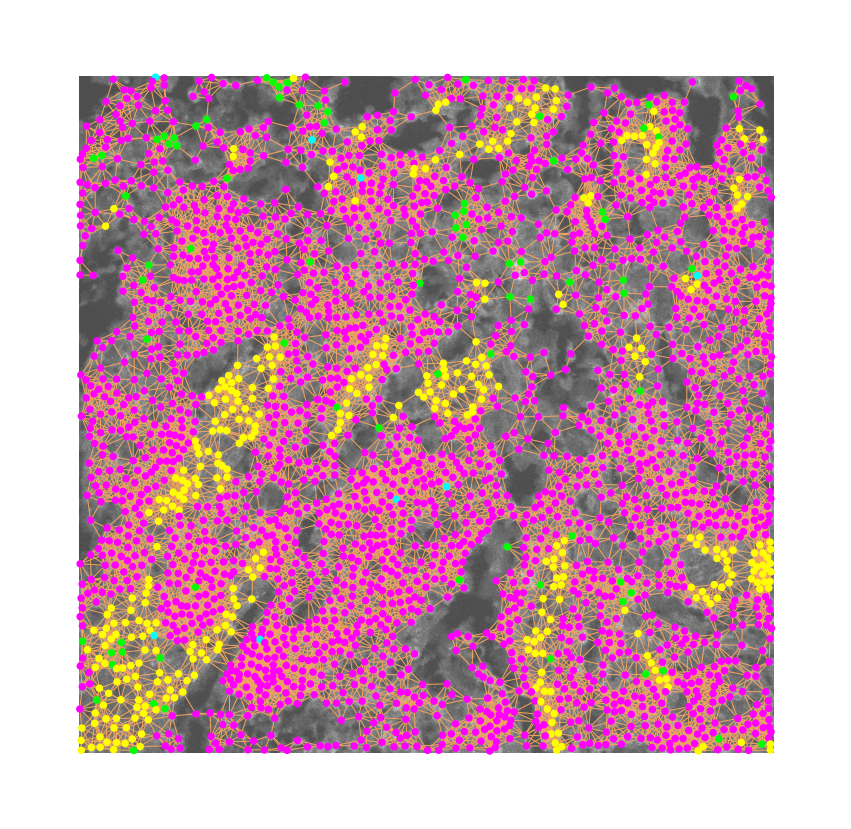

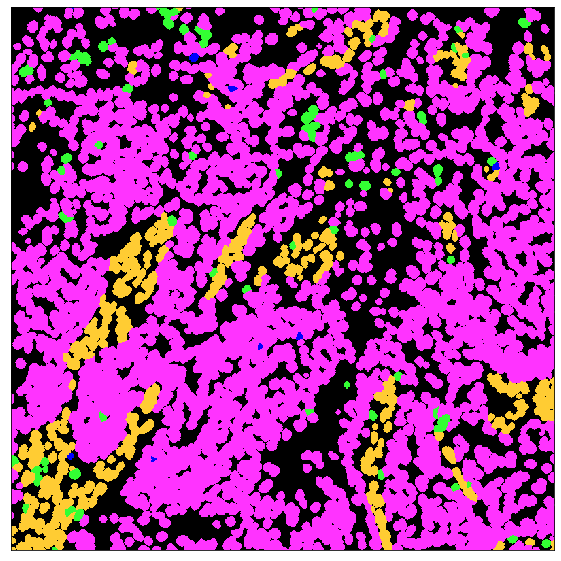

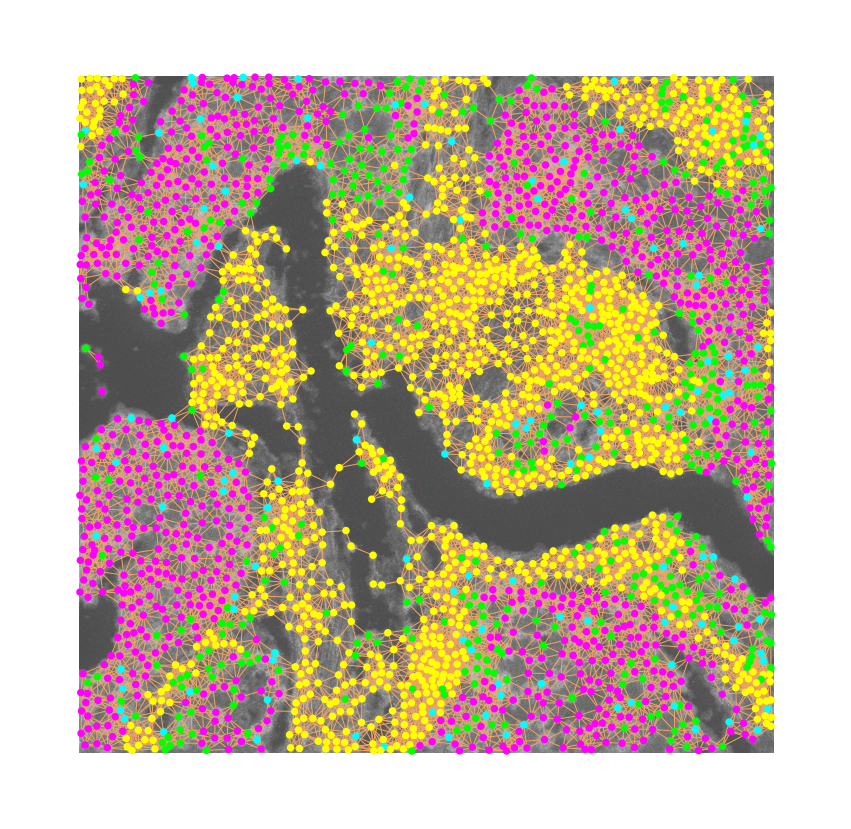

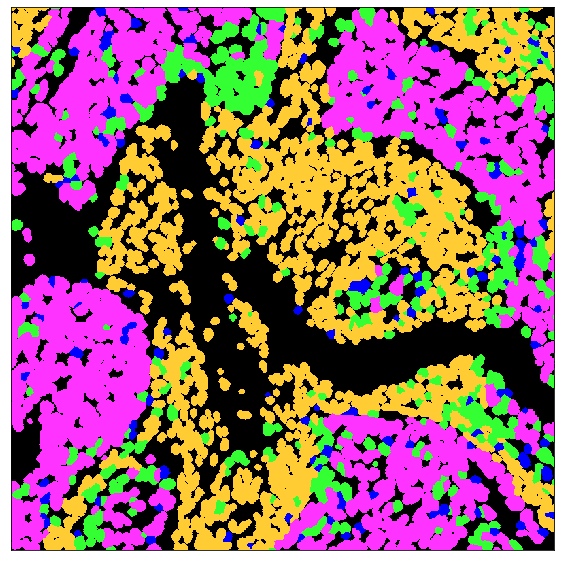

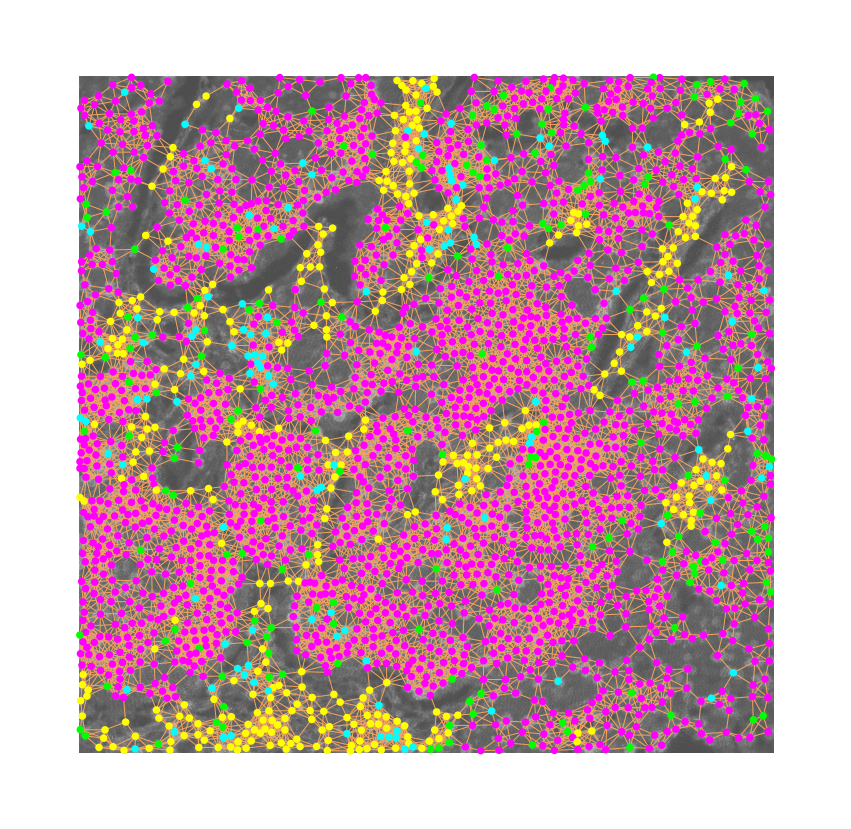

...

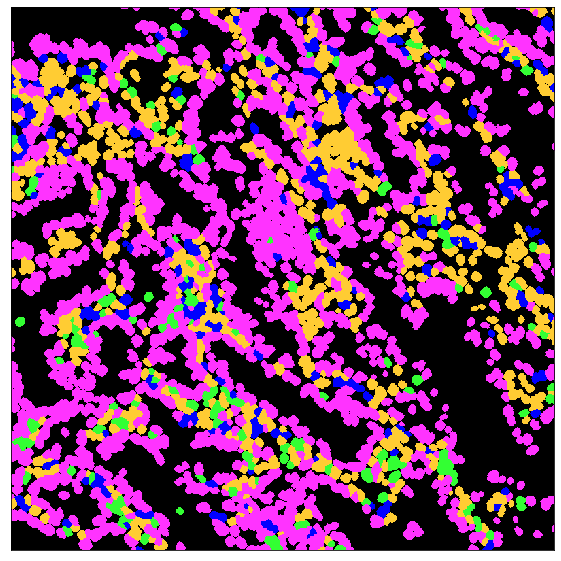

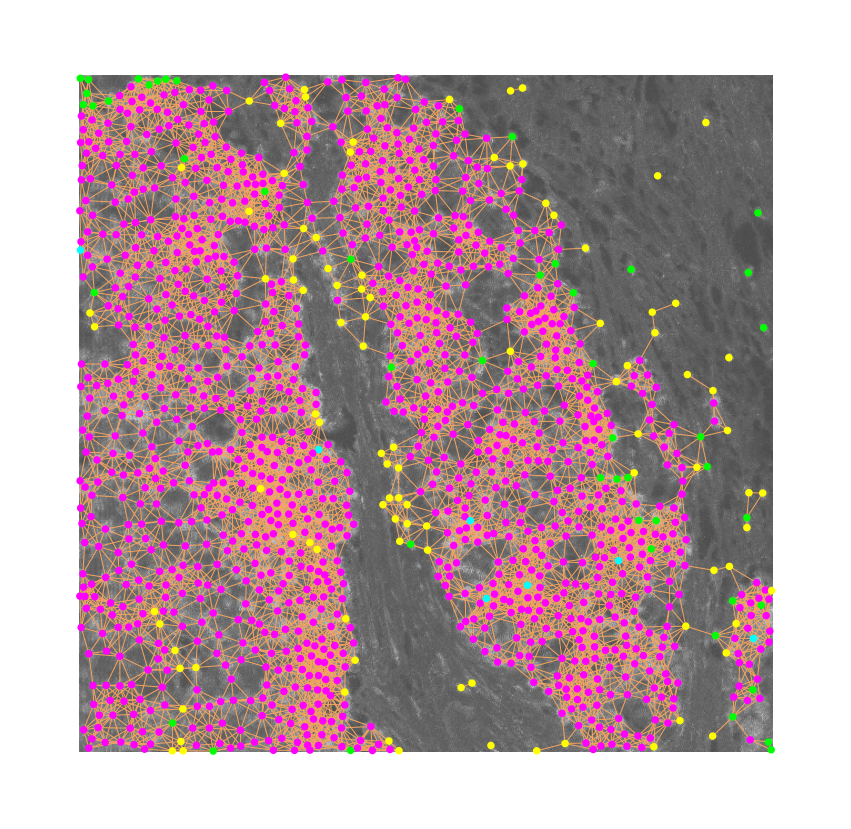

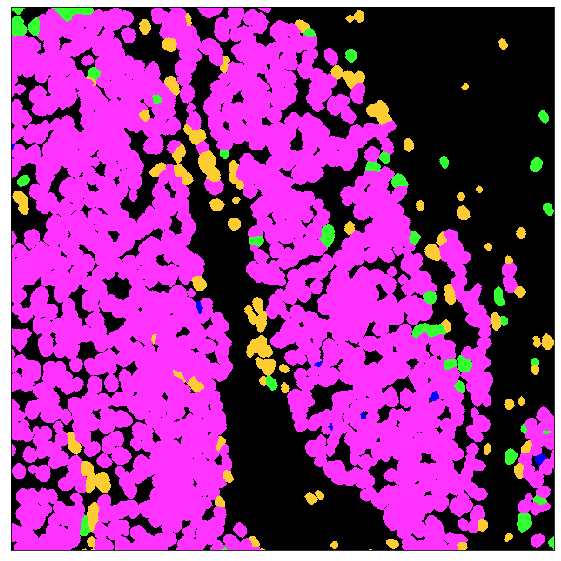

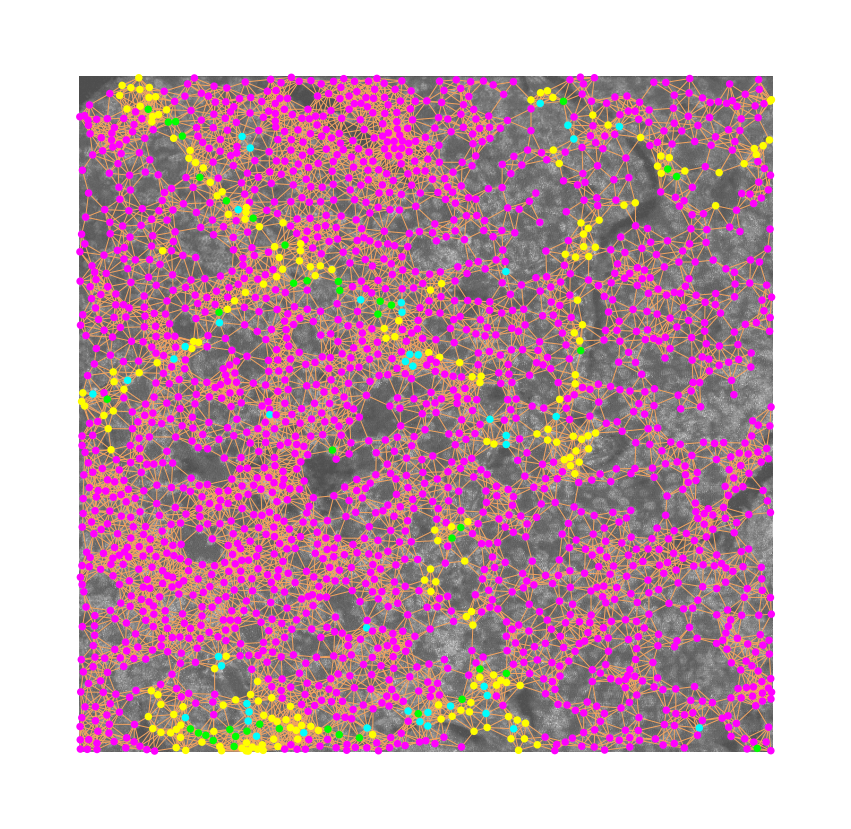

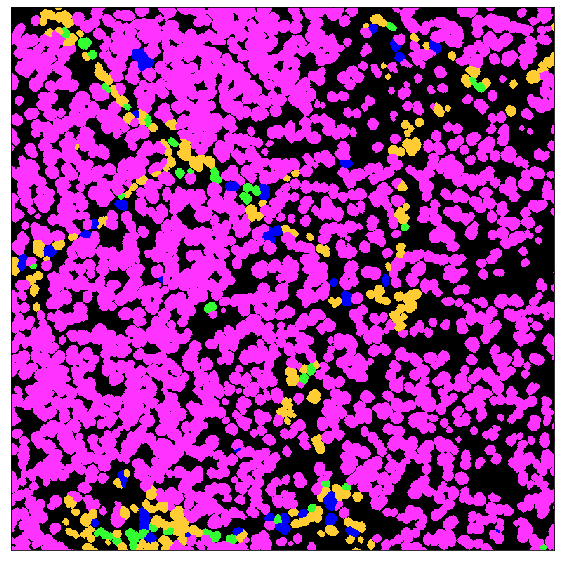

In [11]:
marker_list = [['ECadherin','PanKeratin'], ['CD68'],['CD8a'], ['Col1', 'SMA']]
labels = ['ECA+PanK', 'CD68', 'CD8a', 'Col1+SMA']
rgb = np.array([[255,0,255], [0,255,0], [0,255,255], [255,255,0], [160,160,160]])
mycmap = ListedColormap(rgb/255)
rgb2 = np.array([[255,51,255], [51,255,51], [0,0,255], [255,204,51], [160,160,160]])
mycmap2 = ListedColormap(rgb2/255)
scores = defaultdict(list)
density = defaultdict(list)
scores_count = defaultdict(list)
show=True
n = 25


for dataset in datasets:
    # Read image and cell_mask
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    cell_mask = read_cell_mask(dataset)
    min_shape = min(cell_mask.shape[0], cell_mask.shape[1])
    min_shape = myround(min_shape, base=n)
    cell_mask = cell_mask[:min_shape, :min_shape]

    imgs_list = []
    #     p2, p98 = np.percentile(imgs, (20.0, 99.0))
    for markers in marker_list:
        temp = []
        for marker in markers:
            img = marker2img[marker]
            if marker == 'CD8a':
                img = median(img, disk(1))
            p2, p98 = np.percentile(img, (0, 99.9))
            img = exposure.rescale_intensity(img, in_range=(p2, p98))
            temp.append(img[:min_shape, :min_shape])
        imgs_list.append(np.array(np.mean(temp, axis=(0))))

    # Grayscale backgroun image
    avg_img = np.array(np.mean(imgs, axis=(0)))[:min_shape, :min_shape]

    # Get cell neighbors analysis
    distances, neighbors, cell_labels, graph, X = get_distances(cell_mask)
    df = get_cell_expression_level_mean(imgs_list, labels, cell_mask)
    df['ECA+PanK'] = df['ECA+PanK'] * 0.6
    node_class, node_colors = get_cell_color(df, labels, rgb)

    node_class, _ = get_cell_color(df, labels, rgb)
    neighbor_class = get_nei_info(cell_labels, neighbors, node_class, distances)
    node_patch = get_node_patch(X, node_class, n)

    #Plot proximity map
    fig, ax = plt.subplots(figsize=(15,15))
    ax.axis('off')
    top, right = avg_img.shape
    ax.imshow(avg_img, cmap='gray', alpha=0.7, aspect='auto', extent=[0,right,0,top], origin='lower')
    plot_nn(X, graph, node_colors, ax)
    ax.invert_yaxis()

    #Plot cell mask
    img = replace_with_dict(cell_mask , node_class)
    fig, ax = plt.subplots(figsize=(10,10))
    ax.imshow(img, cmap=mycmap2, interpolation='None', vmin=0, vmax=5)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor('black')
    
    unique, counts = np.unique(img[~np.isnan(img)], return_counts=True)
    density['Tumor'].append(round(counts[0]/img.size,4))
    density['Stroma'].append(round(counts[3]/img.size,4))
    density['IP'].append(round(counts[2]/img.size,4))
    density['IN'].append(round(counts[1]/img.size,4))
    
     # Get Tumor and Stroma island 
    tumor = patch_count(0, node_class, node_patch, n, avg_img.shape)
    inegatif = patch_count(1, node_class, node_patch, n, avg_img.shape)
    ipositif = patch_count(2, node_class, node_patch, n, avg_img.shape)
    stroma = patch_count(3, node_class, node_patch, n, avg_img.shape)
    
    total = [patch_count(i, node_class, node_patch, n, avg_img.shape)  for i in range(5)]
    total = np.sum(total, axis=(0))
    P_tumor = np.divide(tumor, total, out=np.zeros_like(total), where=total!=0)
    P_ip = np.divide(ipositif, total, out=np.zeros_like(total), where=total!=0)
    P_in = np.divide(inegatif, total, out=np.zeros_like(total), where=total!=0)
    P_stroma = np.divide(stroma, total, out=np.zeros_like(total), where=total!=0)

    # IP to tumor
    ip_t_int = patch_count_neighbor(2, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_s_int = patch_count_neighbor(2, 3, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_ip_int = patch_count_neighbor(2, 2, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_in_int = patch_count_neighbor(2, 1, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_int_total = [patch_count_neighbor(2, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
    ip_int_total = np.sum(ip_int_total, axis=(0))
    P_ip_t = np.divide(ip_t_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_s = np.divide(ip_s_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_ip = np.divide(ip_ip_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_in = np.divide(ip_in_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)

    # IN to tumor
    in_t_int = patch_count_neighbor(1, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_ip_int = patch_count_neighbor(1, 2, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_in_int = patch_count_neighbor(1, 1, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_s_int = patch_count_neighbor(1, 3, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_int_total = [patch_count_neighbor(1, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
    in_int_total = np.sum(in_int_total, axis=(0))
    P_in_t = np.divide(in_t_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)
    P_in_s = np.divide(in_s_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)
    P_in_in = np.divide(in_in_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)
    P_in_ip = np.divide(in_ip_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)

    scores['Tumor'].append(round(np.mean(P_tumor),4))
    scores['Stroma'].append(round(np.mean(P_stroma),4))
    scores['IP'].append(round(np.mean(P_ip),4))
    scores['IN'].append(round(np.mean(P_in),4))
    scores['IP_T'].append(round(np.mean(P_ip_t),4))
#     scores['IP_IP'].append(round(np.mean(P_ip_ip),4))
    scores['IP_IN'].append(round(np.mean(P_ip_in),4))
    scores['IP_S'].append(round(np.mean(P_ip_s),4))
    scores['IN_T'].append(round(np.mean(P_in_t),4))
#     scores['IN_IN'].append(round(np.mean(P_in_in),4))
    scores['IN_IP'].append(round(np.mean(P_in_ip),4))
    scores['IN_S'].append(round(np.mean(P_in_s),4))

# Pixels 

In [12]:
DEFAULT_CHANNELS = (1, 2, 3, 4)

RGB_MAP = {
    1: {
        'rgb': np.array([255, 0, 255]),
        'range': [0,255]
    },
    2: {
        'rgb': np.array([0,255,0]),
        'range': [0,255]
    },
    3: {
        'rgb': np.array([0, 0, 255]),
        'range': [0,255]
    },
    4: {
        'rgb': np.array([255, 204, 51]),
        'range': [0,255]
    }
}

def convert_to_rgb(t, channels=DEFAULT_CHANNELS, vmax=255, rgb_map=RGB_MAP):
    """
    Converts and returns the image data as RGB image
    Parameters
    ----------
    t : np.ndarray
        original image data
    channels : list of int
        channels to include
    vmax : int
        the max value used for scaling
    rgb_map : dict
        the color mapping for each channel
        See rxrx.io.RGB_MAP to see what the defaults are.
    Returns
    -------
    np.ndarray the image data of the site as RGB channels
    """
    dim1,dim2,_ = t.shape
    colored_channels = []
    for i, channel in enumerate(channels):
        x = (t[:, :, channel-1] / vmax) / \
            ((rgb_map[channel]['range'][1] - rgb_map[channel]['range'][0]) / 255) + \
            rgb_map[channel]['range'][0] / 255
        x = np.where(x > 1., 1., x)
        x_rgb = np.array(
            np.outer(x, rgb_map[channel]['rgb']).reshape(dim1,dim2, 3),
            dtype=int)
        colored_channels.append(x_rgb)
    im = np.array(np.array(colored_channels).sum(axis=0), dtype=int)
    im = np.where(im > 255, 255, im)
    im = im.astype(np.uint8)
    return im


def one_channel(t, channel, vmax=255, rgb_map=RGB_MAP):
    """
    Converts and returns the image data as RGB image
    Parameters
    ----------
    t : np.ndarray
        original image data
    channels : list of int
        channels to include
    vmax : int
        the max value used for scaling
    rgb_map : dict
        the color mapping for each channel
        See rxrx.io.RGB_MAP to see what the defaults are.
    Returns
    -------
    np.ndarray the image data of the site as RGB channels
    """
    dim1, dim2, _ = t.shape
    colored_channels = []
    x = (t[:, :, 0] / vmax) / (
        (rgb_map[channel]["range"][1] - rgb_map[channel]["range"][0]) / 255
    ) + rgb_map[channel]["range"][0] / 255
    x = np.where(x > 1.0, 1.0, x)
    x_rgb = np.array(
        np.outer(x, rgb_map[channel]["rgb"]).reshape(dim1, dim2, 3), dtype=int
    )
    colored_channels.append(x_rgb)
    im = np.array(np.array(colored_channels).sum(axis=0), dtype=int)
    im = np.where(im > 255, 255, im)
    im = im.astype(np.uint8)
    return im

In [13]:
from skimage.measure import block_reduce
from scipy.ndimage import distance_transform_edt

def tile_array(a, b0, b1):
    r, c = a.shape                                    # number of rows/columns
    rs, cs = a.strides                                # row/column strides 
    x = as_strided(a, (r, b0, c, b1), (rs, 0, cs, 0)) # view a as larger 4D array
    return x.reshape(r*b0, c*b1)                      # create new 2D array

def mean_block(img, block_size):
    img_reduced = tile_array(block_reduce(img, block_size=block_size, func=np.mean), block_size[0], block_size[0])
#     img_reduced = (img_reduced - img_reduced.min())/(img_reduced.max() - img_reduced.min())
    img_reduced /= 255
    return img_reduced

def myround(x, base=5):
    return base * round(x/base)

def plot_mean(imgs_list, n, labels):
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(mean_block(imgs_list[c], (n,n)))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = 'RdYlBu_r', norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Intensity')
    plt.show()
    return patch_matrix

def plot_combined(imgs_list, n, int_min=0.05):
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(mean_block(imgs_list[c], (n,n)))
    patch_matrix = np.array(patch_matrix)
    patch_max = np.argmax(patch_matrix, axis=(0))
    patch_max = np.where(np.all(patch_matrix < int_min, axis=0), np.nan, patch_max)
    
    rgb = np.array([[255,51,255], [51,255,51], [0,0,255], [255,204,51]])/255
#     rgb = np.array([[255,0,255], [0,255,0], [0,255,255], [255,255,0]])/255
    cmap = ListedColormap(rgb)
                   
    fig, ax = plt.subplots(figsize = (10,10))
    ax.imshow(patch_max, cmap=cmap, vmin=0, vmax=3, interpolation='none')
    ax.set_facecolor('black')
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    return patch_max

In [14]:
def get_proportion(patch_max, n):
    img_size = patch_max.shape[0] * patch_max.shape[1]
    P = np.count_nonzero(patch_max == n) / img_size
    return P

def get_label_img(patch_max, n):
    labels = measure.label(patch_max == n, background=0, connectivity=2)
    return labels

def get_contour(labeled_img, n = 2):
    labels = np.unique(labeled_img)[1:]
    contours = []
    labels_filtered = []
    
    for label in labels:
        mask_label = (labeled_img == label)
        labels_filtered.append(label)
        mask_label = ~mask_label
        distances = distance_transform_edt(mask_label)
        contour = np.where(np.logical_and(distances>0, distances<n), 1, 0)
        row, col = np.where(contour > 0)
        contours.append(np.array(list(zip(row, col))))
        
    return labels_filtered, contours

def get_neighbor_env(img_labeled, patch_max, n_size=2, show=True):
    props = measure.regionprops(img_labeled)
    areas = []
    labels = []
    counts = []
    bboxs = []
    for prop in props:
        if prop['area'] > 1:
            bbox = np.asarray(prop['bbox'])
            bbox += np.array([-n_size, -n_size , n_size , n_size])
            bbox = np.clip(bbox, a_min = 0, a_max = None)
            row_min, col_min, row_max, col_max = bbox

            patch_max_roi = patch_max[row_min: row_max, col_min:col_max]
            size = patch_max_roi.size
            patch_max_roi = patch_max_roi[~np.isnan(patch_max_roi)].astype(int)
            count = Counter(patch_max_roi[~np.isnan(patch_max_roi)])   
            count = {k:v/size for k,v in count.items()}
            counts.append(count)
            areas.append(prop['area'])
            labels.append(prop['label'])
            bboxs.append(bbox)


    if show:
        rgb = np.array([[255,51,255], [51,255,51], [0,0,255], [255,204,51]])/255
        cmap = ListedColormap(rgb)
        fig, ax = plt.subplots( figsize=(10,10))
        ax.imshow(patch_max, cmap=cmap, vmin=0, vmax=3, interpolation='none')
        ax.set_facecolor('black')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        for bbox in bboxs:
            row_min, col_min, row_max, col_max = bbox
            ax.add_patch(Rectangle((col_min-1, row_min-1), col_max-col_min+1, row_max-row_min+1, fill=None, alpha=1, edgecolor='b', lw=2))
    return counts, areas, labels, bboxs

def get_contour_env(img_labeled, contours, patch_max, n=1,show=True):
    if show:
        mask = np.zeros(img_labeled.shape)
        for contour in contours:
            mask[contour[:, 0], contour[:, 1]] = 1
        fig, ax = plt.subplots(figsize=(10,10))
        ax.imshow(mask, cmap='gray', interpolation=None)
        ax.imshow(np.where(img_labeled == 0, np.nan, n), cmap='Set1', vmin=0, vmax=9, interpolation=None)
        ax.axis('off')
    
    counts = []
    for contour in contours:
        env = patch_max[contour[:,0], contour[:,1]]
        size = len(env)
        count = Counter(env[~np.isnan(env)].astype(int))   
        count = {k:v/size for k,v in count.items()}
        counts.append(count)
        
    return counts

def get_interaction(counts):
    tumor_int = []
    stroma_int = []
    ip_int = []
    in_int = []

    for count in counts:
        tumor_int.append(count.get(0, 0.))
        in_int.append(count.get(1, 0.))
        ip_int.append(count.get(2, 0.))
        stroma_int.append(count.get(3, 0.))

    tumor_int = np.mean(tumor_int)
    stroma_int = np.mean(stroma_int)
    ip_int = np.mean(ip_int)
    in_int = np.mean(in_int)

    return tumor_int, stroma_int, ip_int, in_int



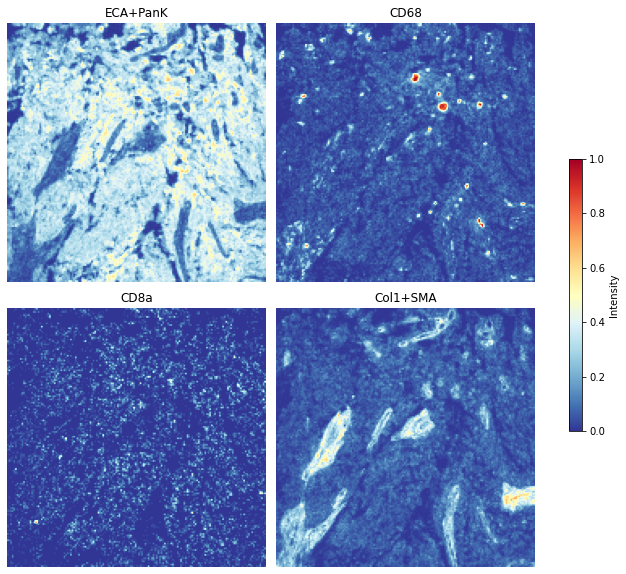

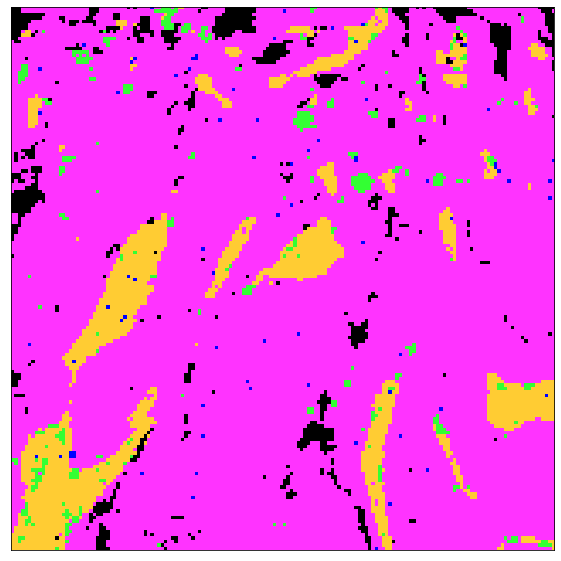

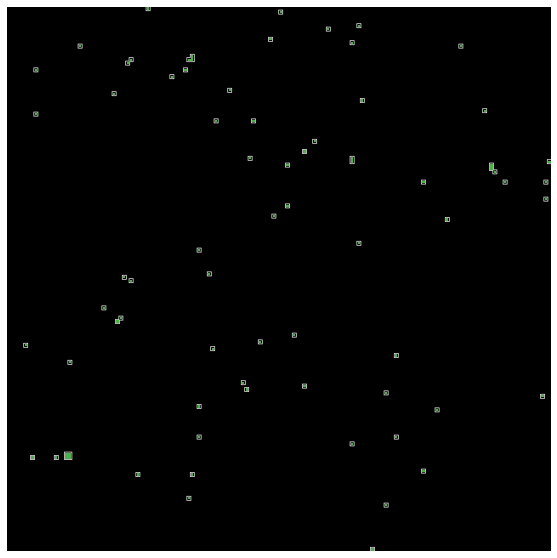

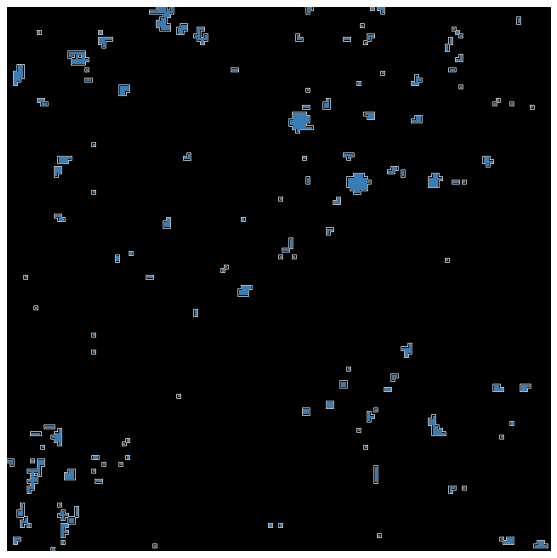

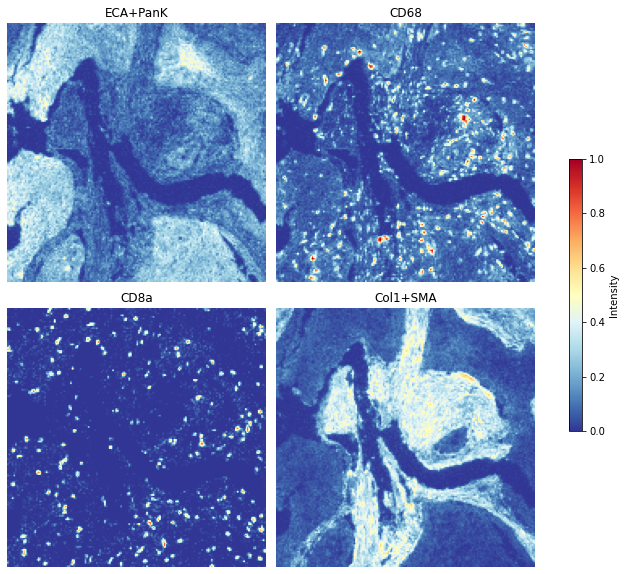

...

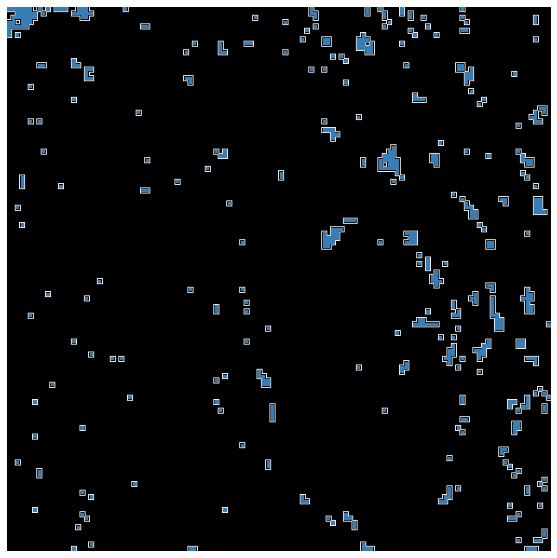

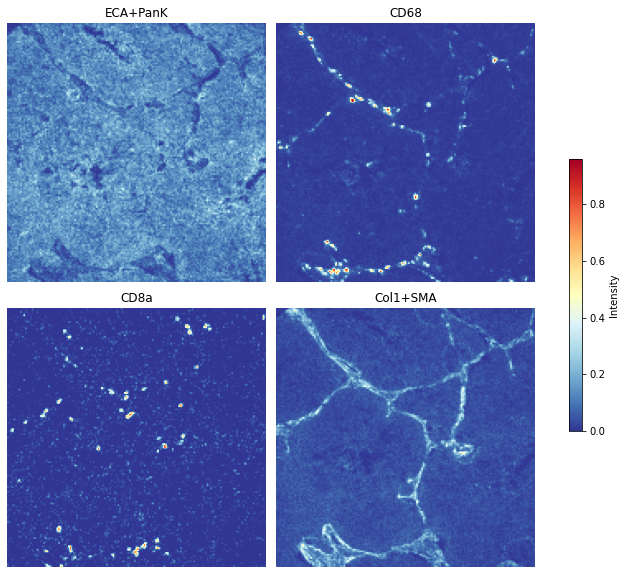

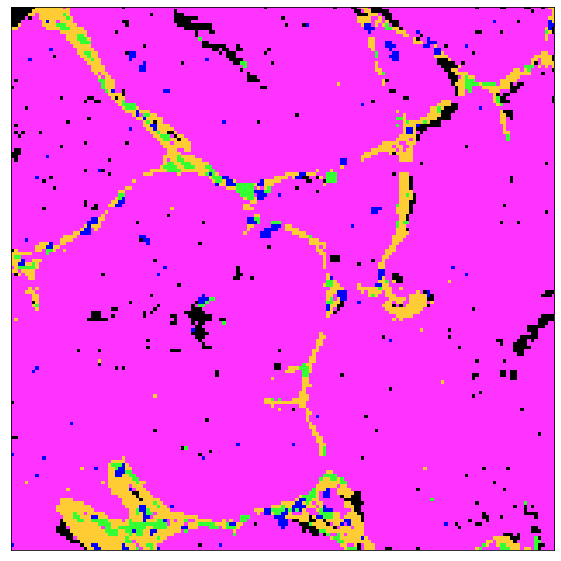

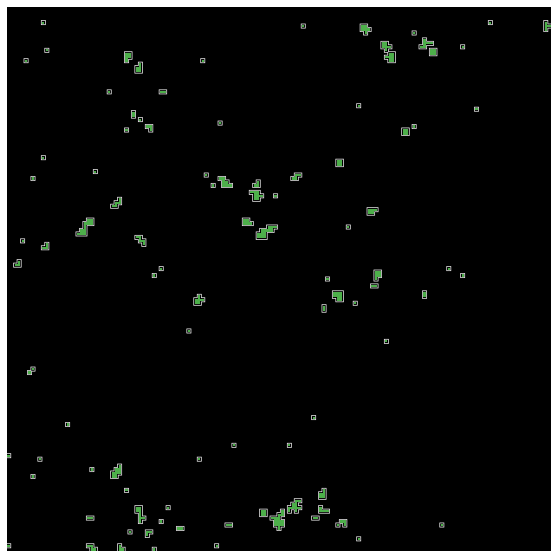

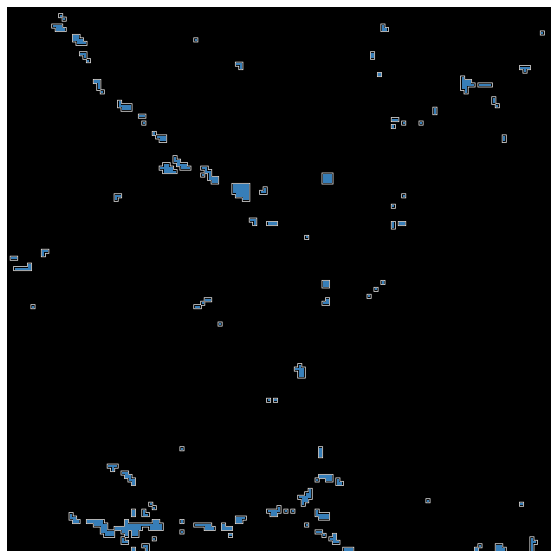

In [15]:
from skimage.restoration import denoise_bilateral
from collections import Counter

n = 5
scores_pixels = defaultdict(list)

for dataset in datasets:

    # Read image and cell_mask
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    min_shape = min(imgs[0].shape[0], imgs[0].shape[1])
    min_shape = myround(min_shape, base=n)
#     p2, p98 = np.percentile(imgs, (20.0, 99.0))
    imgs_list = []
    for markers in marker_list:
        temp = []
        for marker in markers:
            img = marker2img[marker]
            if marker == 'CD8a':
                img = median(img, disk(1))
            p2, p98 = np.percentile(img, (0, 99.9))
            img = exposure.rescale_intensity(img, in_range=(p2, p98))
            temp.append(img[:min_shape, :min_shape])
        imgs_list.append(np.array(np.mean(temp, axis=(0))))

    # Grayscale backgroun image
    data = np.stack(imgs_list, axis=2)[:min_shape, :min_shape]
    
    # Pixel
    patch_matrix = plot_mean(imgs_list, n, labels)
    patch_max = plot_combined(imgs_list, n)
    
    scores_pixels['Tumor'].append(get_proportion(patch_max, 0))
    IN_prop = get_proportion(patch_max, 1)
    scores_pixels['IN'].append(IN_prop)
    IP_prop = get_proportion(patch_max, 2)
    scores_pixels['IP'].append(IP_prop)
    scores_pixels['Stroma'].append(get_proportion(patch_max, 3))
    
    IN_labels = get_label_img(patch_max, 1)
    IP_labels = get_label_img(patch_max, 2)
    
    # Immune positif
    _, contours = get_contour(IP_labels, n=2)
    counts = get_contour_env(IP_labels, contours, patch_max, n=2)
    tumor_int, stroma_int, ip_int, in_int = get_interaction(counts)
    
    scores_pixels['IP_T'].append(tumor_int*IP_prop)
    scores_pixels['IP_S'].append(stroma_int*IP_prop)
    scores_pixels['IP_IN'].append(in_int*IP_prop)
    
    # Immune negatif
    _, contours = get_contour(IN_labels, n=2)
    counts = get_contour_env(IN_labels, contours, patch_max)
    tumor_int, stroma_int, ip_int, in_int = get_interaction(counts)

    scores_pixels['IN_T'].append(tumor_int*IN_prop)
    scores_pixels['IN_S'].append(stroma_int*IN_prop)
    scores_pixels['IN_IP'].append(ip_int*IN_prop)

# Create df

In [16]:
df_cell_density = pd.DataFrame(density, index=datasets)
df_cell_density.index = [index[-2:] for index in df_cell_density.index]
df_cell_density.sort_values('IP', inplace=True)
order = df_cell_density.index.tolist()
df_cell_density.index.name = 'ROI'
df_cell_density.reset_index(inplace=True)
df_cell_density = df_cell_density.melt(id_vars=['ROI'], var_name = 'Type', value_name='Density')
df_cell_density['Method'] = 'Cell'

In [17]:
df_cell = pd.DataFrame(scores, index=datasets)
df_cell.index = [index[-2:] for index in df_cell.index]

In [18]:
df_pixels = pd.DataFrame(scores_pixels, index=datasets)
df_pixels.index = [index[-2:] for index in df_pixels.index]
df_pixels.index.name = 'ROI'
df_pixels_density = df_pixels.iloc[:,:4]
df_pixels_density.reset_index(inplace=True)
df_pixels_density = df_pixels_density.melt(id_vars=['ROI'], var_name = 'Type', value_name='Density')
df_pixels_density['Method'] = 'Pixel'

# Combined

In [19]:
df_all = pd.concat([df_cell_density, df_pixels_density])

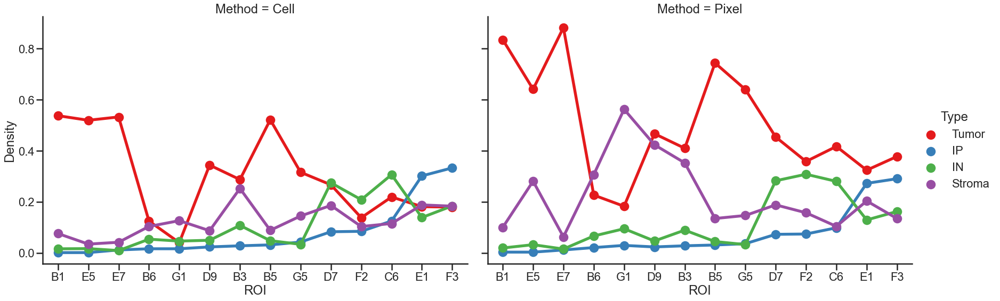

In [20]:
sns.set_style("ticks")
sns.set_context("poster")

g = sns.catplot(x="ROI", y="Density", hue="Type", col="Method",
                palette="Set1", order=order, hue_order=['Tumor', 'IP', 'IN', 'Stroma'], height=8, aspect=1.5,
                kind="point", data=df_all)


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Tumor_Cell v.s. Tumor_Pixel: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.797e-02 U_stat=4.600e+01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Stroma_Cell v.s. Stroma_Pixel: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.294e-02 U_stat=4.800e+01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

IP_Cell v.s. IP_Pixel: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=9.817e-01 U_stat=9.800e+01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p 

(<AxesSubplot:ylabel='Density'>,
 [<statannot.StatResult.StatResult at 0x25799cb2430>])

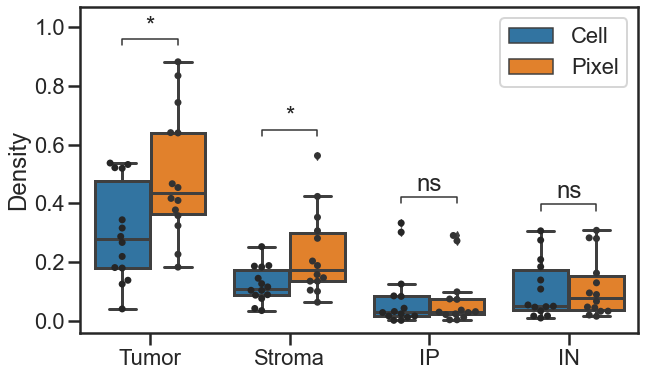

In [21]:
from statannot import add_stat_annotation

fig, ax = plt.subplots(figsize=(10,6))
ax = sns.boxplot(x='Type', y='Density', hue='Method', data=df_all)
ax = sns.swarmplot(x='Type', y='Density', hue='Method', data=df_all, dodge=True, color=".2", size=7)
ax.set(xlabel='', ylabel='Density')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[:2], labels[:2])

box_pairs = [((t, 'Cell'), (t, 'Pixel')) for t in df_all.Type.unique()]

add_stat_annotation(ax, x='Type', y='Density', hue='Method', data=df_all, 
                                   box_pairs=[(('Tumor', 'Cell'), ('Tumor', 'Pixel'))],
                                   test='Mann-Whitney', loc='inside', verbose=2)
add_stat_annotation(ax, x='Type', y='Density', hue='Method', data=df_all, 
                                   box_pairs=[(('Stroma', 'Cell'), ('Stroma', 'Pixel'))],
                                   test='Mann-Whitney', loc='inside', verbose=2)
add_stat_annotation(ax, x='Type', y='Density', hue='Method', data=df_all, 
                                   box_pairs=[(('IP', 'Cell'), ('IP', 'Pixel'))],
                                   test='Mann-Whitney', loc='inside', verbose=2)
add_stat_annotation(ax, x='Type', y='Density', hue='Method', data=df_all, 
                                   box_pairs=[(('IN', 'Cell'), ('IN', 'Pixel'))],
                                   test='Mann-Whitney', loc='inside', verbose=2)

# Comparison

In [22]:
df_cell_ = df_cell.add_prefix('Cell ')

In [23]:
df_pixels_ = df_pixels.add_prefix('Pixel ')

In [24]:
df_all = pd.concat([df_cell_, df_pixels_], axis=1)

In [25]:
df_all

,Cell Tumor,Cell Stroma,Cell IP,Cell IN,Cell IP_T,Cell IP_IN,Cell IP_S,Cell IN_T,Cell IN_IP,Cell IN_S,Pixel Tumor,Pixel IN,Pixel IP,Pixel Stroma,Pixel IP_T,Pixel IP_S,Pixel IP_IN,Pixel IN_T,Pixel IN_S,Pixel IN_IP
B1,0.7808,0.1222,0.0022,0.0274,0.0068,0.0002,0.0008,0.0393,0.0003,0.0132,0.835156,0.019141,0.002969,0.099961,0.002323,0.000565,0.000058,0.012211,0.006353,0.000150
B3,0.3335,0.3743,0.0404,0.1433,0.0512,0.0258,0.0331,0.0877,0.0188,0.1076,0.409883,0.089023,0.027734,0.352500,0.013106,0.010322,0.003771,0.039750,0.041834,0.003694
B5,0.6776,0.1491,0.0464,0.0702,0.0590,0.0122,0.0275,0.0957,0.0115,0.0300,0.743867,0.044336,0.030820,0.134687,0.019025,0.008287,0.001940,0.029311,0.010969,0.001896
C6,0.2510,0.1695,0.1392,0.3807,0.0987,0.1218,0.0695,0.1551,0.1006,0.0810,0.416914,0.280117,0.098281,0.103867,0.054178,0.011475,0.029486,0.172258,0.044060,0.043092
D7,0.2997,0.2393,0.1056,0.3545,0.0872,0.1159,0.0990,0.1100,0.0726,0.1439,0.453906,0.282500,0.072656,0.188047,0.032280,0.014516,0.025769,0.132090,0.111044,0.037038
D9,0.4331,0.2247,0.0468,0.0767,0.0406,0.0141,0.0256,0.0494,0.0118,0.0267,0.466875,0.046602,0.023281,0.423594,0.011416,0.008691,0.002510,0.017670,0.024994,0.002263
E1,0.2044,0.2297,0.3787,0.1706,0.1289,0.1413,0.1464,0.0723,0.2115,0.0972,0.323984,0.129062,0.272422,0.203359,0.116022,0.090771,0.048285,0.037360,0.036893,0.047715
B6,0.2703,0.2873,0.0377,0.1175,0.0268,0.0109,0.0272,0.0683,0.0102,0.0462,0.226328,0.066172,0.020742,0.306406,0.007436,0.004271,0.001588,0.025059,0.018340,0.002994
F3,0.2170,0.1978,0.3786,0.1979,0.0990,0.1754,0.1726,0.0462,0.2505,0.1306,0.377617,0.162188,0.290469,0.134414,0.135487,0.070547,0.076948,0.057009,0.032046,0.070995
F2,0.2098,0.1641,0.1357,0.3596,0.0621,0.0785,0.0653,0.1004,0.0688,0.0732,0.358125,0.308008,0.073867,0.157109,0.033980,0.019032,0.017764,0.175185,0.072243,0.032804


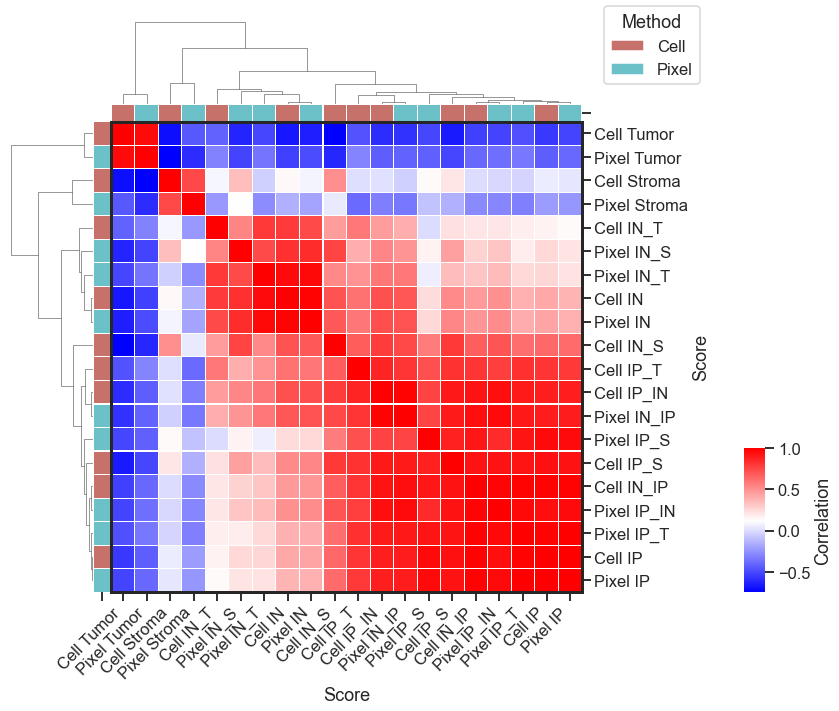

In [36]:
from matplotlib.patches import Patch


CellSizePixels=40
my_cmap = 'bwr'
scale_name = 'Correlation'

sns.set_style("ticks")
sns.set_context("talk")

# Create a categorical palette to identify the networks
method = ['Cell', 'Pixel']
method_pal = sns.hls_palette(2, s=.45)
method_lut = dict(zip(map(str, method), method_pal))

methods = [name.split()[0] for name in df_all.columns.tolist()]
method_colors = pd.Series(methods, index=df_all.columns).map(method_lut)

ax = sns.clustermap(
    df_all.corr(),
    cbar_kws={"fraction": 0.01},
    cmap=my_cmap,
    linewidth=0.1,
    dendrogram_ratio=(0.15, 0.15),
    row_colors = method_colors,
    col_colors= method_colors,
    figsize=(10, 10),
)
ax.ax_heatmap.set_yticklabels(ax.ax_heatmap.get_yticklabels(), rotation=0)
ax.ax_heatmap.set_xticklabels(
    ax.ax_heatmap.get_xticklabels(), rotation=45, horizontalalignment="right"
)
ax.ax_heatmap.set_xlabel("Score")
ax.ax_heatmap.set_ylabel("Score")

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name)

pos = ax.ax_heatmap.get_position()
cbar_size=0.2
ax.ax_cbar.set_position((1.05, pos.y0, .03, cbar_size))

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)
    
handles = [Patch(facecolor=method_lut[name]) for name in method_lut]
plt.legend(handles, method_lut, title='Method',
           bbox_to_anchor=(1, 1), bbox_transform=plt.gcf().transFigure, loc='upper right')

In [27]:
top_n = 5
df_corr = df_all.corr()
df_top = pd.DataFrame({n: df_corr.T[col].nlargest(top_n).index.tolist()
                     for n, col in enumerate(df_corr.T)}).T
df_top_values = pd.DataFrame({n: df_corr.T[col].nlargest(top_n).tolist()
                     for n, col in enumerate(df_corr.T)}).T

metrics = df_corr.index.tolist()
top_list = df_top.values.tolist()
top_values = df_top_values.values.tolist()

In [28]:
import networkx as nx
from collections import defaultdict 

top5 = defaultdict(dict)

for i, top_list in enumerate(top_list):
    neighbors = {}
    for n, ele in enumerate(top_list):
        if n == 0:
            continue
        neighbors[ele] = {"weight": top_values[i][n]}
    top5[metrics[i]] = neighbors
    
    

In [29]:
G = nx.from_dict_of_dicts(top5)

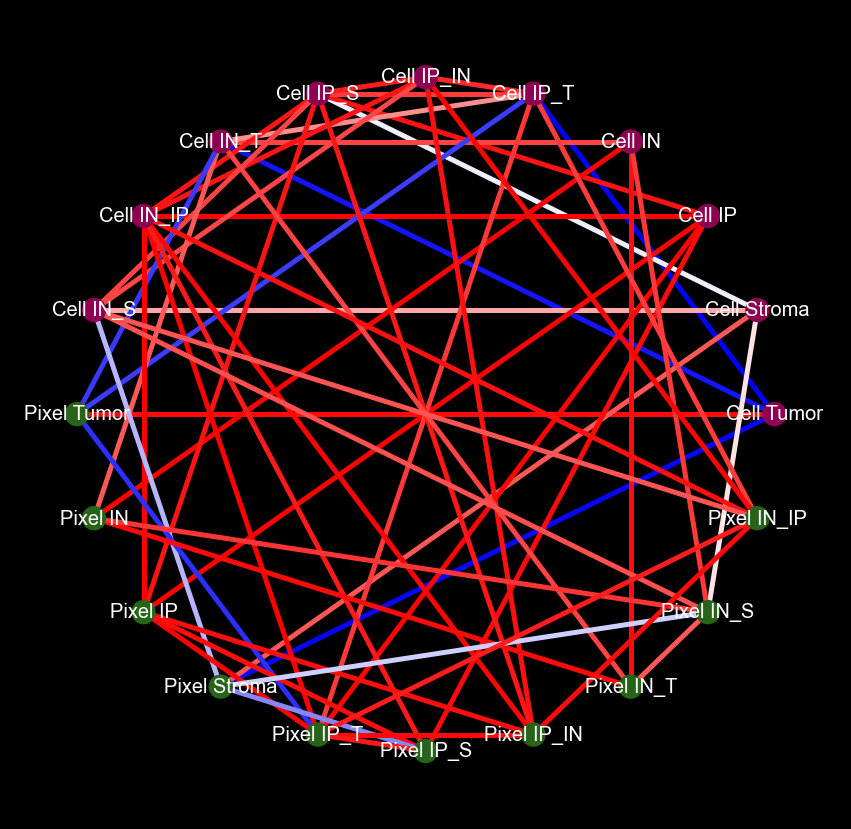

In [30]:
edges = G.edges()
weights = np.array([G[u][v]["weight"] for u, v in edges])
edge_c = weights
edge_w = 5
pos = nx.circular_layout(G)
nodes = list(G.nodes)
label = [0 if node.split(' ')[0] == 'Cell' else 1 for node in nodes]

fig, ax = plt.subplots(figsize=(15, 15))
nx.draw(
    G,
    pos=pos,
    with_labels=True,
    node_size=500,
    node_color=label,
    cmap='PiYG',
    font_size=20,
    font_color="white",
    width=edge_w,
    edge_color=edge_c,
    edge_cmap=plt.cm.bwr,
)

fig.set_facecolor("black")
x_values, y_values = zip(*pos.values())
x_max = max(x_values)
x_min = min(x_values)
x_margin = (x_max - x_min) * 0.1
plt.xlim(x_min - x_margin, x_max + x_margin)
plt.show()

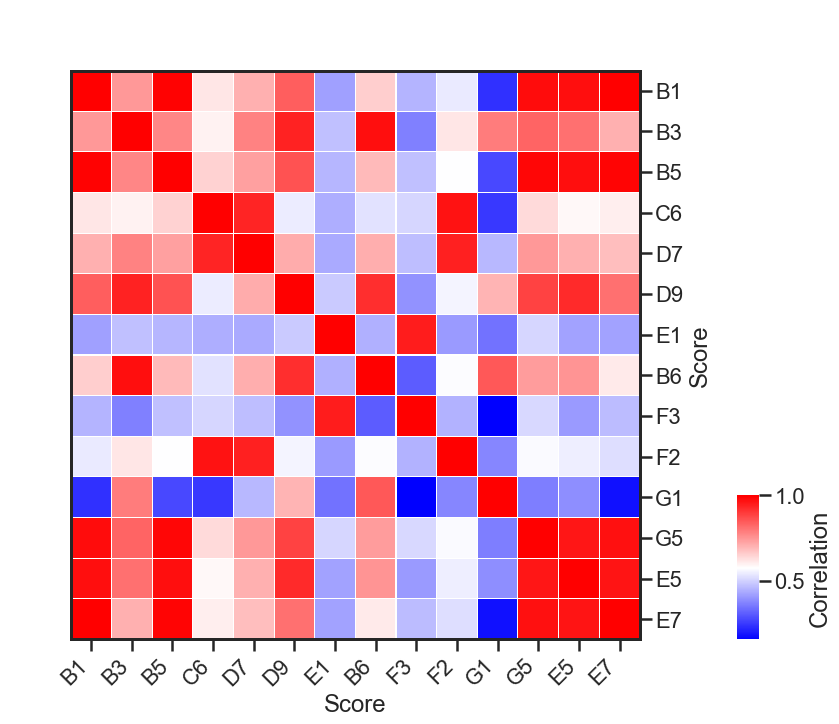

In [31]:
from matplotlib.patches import Patch


ellSizePixels=40
my_cmap = 'bwr'
scale_name = 'Correlation'


# Create a categorical palette to identify the networks
method = ['Cell', 'Pixel']
method_pal = sns.hls_palette(2, s=.45)
method_lut = dict(zip(map(str, method), method_pal))

methods = [name.split()[0] for name in df_all.T.columns.tolist()]
method_colors = pd.Series(methods, index=df_all.T.columns).map(method_lut)

ax = sns.clustermap(
    df_all.T.corr(),
    cbar_kws={"fraction": 0.01},
    cmap=my_cmap,
    linewidth=0.1,
    dendrogram_ratio=(0.1, 0.1),
    row_cluster=False,
    col_cluster=False,
    figsize=(10, 10),
)
ax.ax_heatmap.set_yticklabels(ax.ax_heatmap.get_yticklabels(), rotation=0)
ax.ax_heatmap.set_xticklabels(
    ax.ax_heatmap.get_xticklabels(), rotation=45, horizontalalignment="right"
)
ax.ax_heatmap.set_xlabel("Score")
ax.ax_heatmap.set_ylabel("Score")

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name)

pos = ax.ax_heatmap.get_position()
cbar_size=0.2
ax.ax_cbar.set_position((1.05, pos.y0, .03, cbar_size))

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)
    


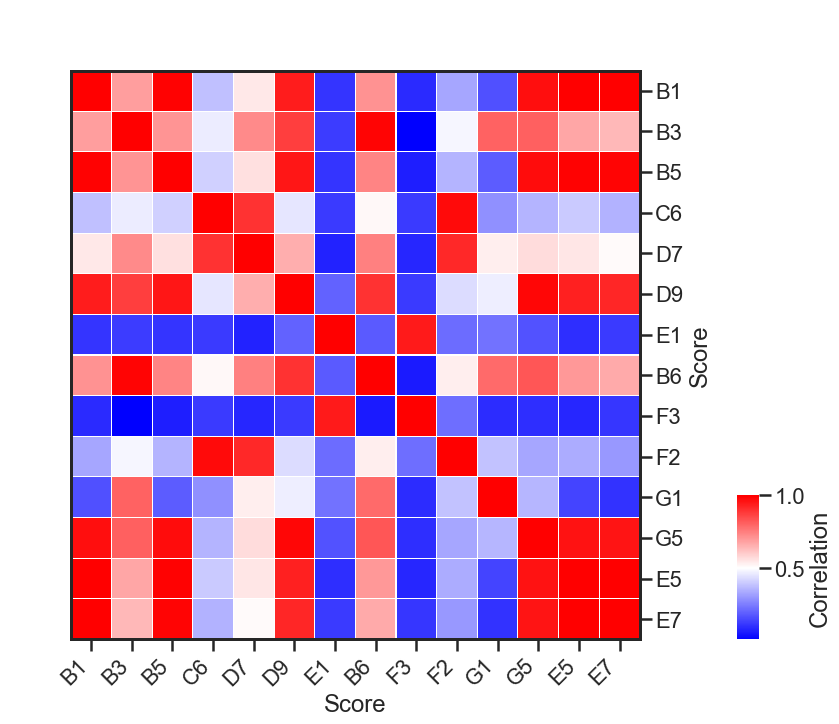

In [32]:
from matplotlib.patches import Patch


ellSizePixels=40
my_cmap = 'bwr'
scale_name = 'Correlation'


# Create a categorical palette to identify the networks
method = ['Cell', 'Pixel']
method_pal = sns.hls_palette(2, s=.45)
method_lut = dict(zip(map(str, method), method_pal))

methods = [name.split()[0] for name in df_cell.T.columns.tolist()]
method_colors = pd.Series(methods, index=df_cell.T.columns).map(method_lut)

ax = sns.clustermap(
    df_cell.T.corr(),
    cbar_kws={"fraction": 0.01},
    cmap=my_cmap,
    linewidth=0.1,
    dendrogram_ratio=(0.1, 0.1),
    row_cluster=False,
    col_cluster=False,
    figsize=(10, 10),
)
ax.ax_heatmap.set_yticklabels(ax.ax_heatmap.get_yticklabels(), rotation=0)
ax.ax_heatmap.set_xticklabels(
    ax.ax_heatmap.get_xticklabels(), rotation=45, horizontalalignment="right"
)
ax.ax_heatmap.set_xlabel("Score")
ax.ax_heatmap.set_ylabel("Score")

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name)

pos = ax.ax_heatmap.get_position()
cbar_size=0.2
ax.ax_cbar.set_position((1.05, pos.y0, .03, cbar_size))

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)
    


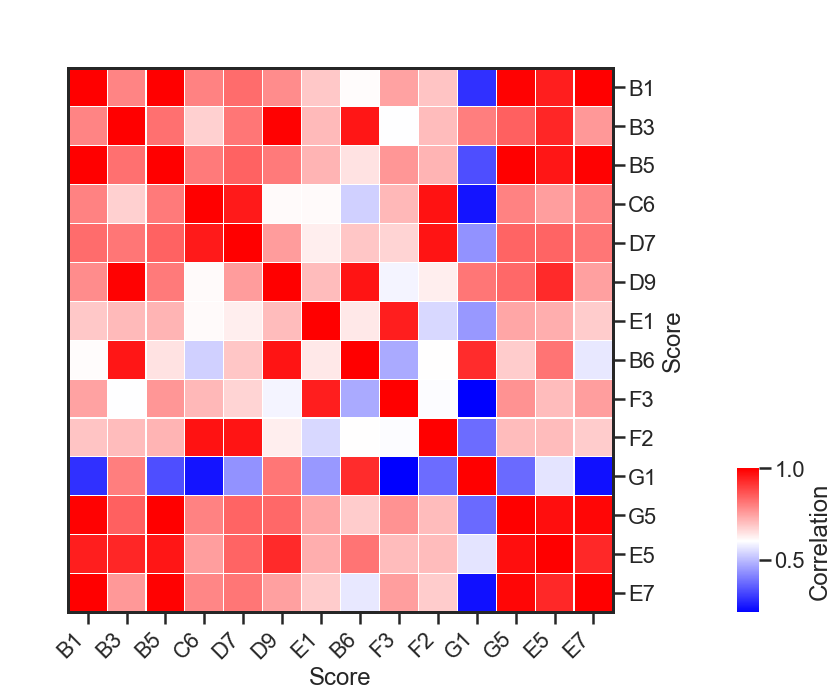

In [33]:
from matplotlib.patches import Patch


ellSizePixels=40
my_cmap = 'bwr'
scale_name = 'Correlation'


# Create a categorical palette to identify the networks
method = ['Cell', 'Pixel']
method_pal = sns.hls_palette(2, s=.45)
method_lut = dict(zip(map(str, method), method_pal))

methods = [name.split()[0] for name in df_pixels.T.columns.tolist()]
method_colors = pd.Series(methods, index=df_pixels.T.columns).map(method_lut)

ax = sns.clustermap(
    df_pixels.T.corr(),
    cbar_kws={"fraction": 0.01},
    cmap=my_cmap,
    linewidth=0.1,
    dendrogram_ratio=(0.1, 0.1),
    row_cluster=False,
    col_cluster=False,
    figsize=(10, 10),
)
ax.ax_heatmap.set_yticklabels(ax.ax_heatmap.get_yticklabels(), rotation=0)
ax.ax_heatmap.set_xticklabels(
    ax.ax_heatmap.get_xticklabels(), rotation=45, horizontalalignment="right"
)
ax.ax_heatmap.set_xlabel("Score")
ax.ax_heatmap.set_ylabel("Score")

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name)

pos = ax.ax_heatmap.get_position()
cbar_size=0.2
ax.ax_cbar.set_position((1.05, pos.y0, .03, cbar_size))

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)
    
